# Annotations using clustering for cells for pancreatic_s1

In [1]:
slide_id = "pancreatic_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_pancreatic_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 41014, 19068), (3, 20507, 9534)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 11) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (235099, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (235099, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (235099, 380)
      └── 'table_nuclei': AnnData (235099, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 235099 × 380
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count
0,aaaaaaaa-1,181,0,0,0,0,181,116.503129,27.274376,cell_labels,5.0,1.0
1,aaaaaaab-1,72,0,0,0,0,72,35.899220,6.050938,cell_labels,5.0,1.0
2,aaaaaaac-1,77,0,0,0,0,77,58.567658,32.060939,cell_labels,5.0,1.0
3,aaaaaaad-1,77,0,0,0,0,77,57.483908,27.319532,cell_labels,5.0,1.0
4,aaaaaaae-1,198,0,0,0,0,198,187.398444,30.525626,cell_labels,5.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
235094,aaadjgfg-1,71,0,0,0,0,71,100.698441,15.488594,cell_labels,6.0,1.0
235095,aaadjgfh-1,159,1,0,0,0,160,151.589537,47.368908,cell_labels,5.0,1.0
235096,aaadjgfi-1,56,0,0,0,0,56,44.885314,6.908907,cell_labels,6.0,1.0
235097,aaadjgfj-1,32,0,0,0,0,32,38.247345,6.818594,cell_labels,6.0,1.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2M,ENSG00000175899,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTB,ENSG00000075624,Gene Expression,Unknown
ADAM28,ENSG00000042980,Gene Expression,Unknown
...,...,...,...
VEGFA,ENSG00000112715,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VSIR,ENSG00000107738,Gene Expression,Unknown
XBP1,ENSG00000100219,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 148262 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs19', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.2_colors', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.4_colors', 'pca_n10_pcs19_leiden_res0.6', 'pca_n10_pcs19_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs19_leiden_res0.2', 'rank_genes_pca_n10_pcs19_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs19_connectivities', 'pca_n10_pcs19_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs19_leiden_res0.2,pca_n10_pcs19_leiden_res0.4,pca_n10_pcs19_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,25.266123,Epsilon cell,45,2,2,1,1,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,5.193449,CD8 T,17,2,4,7,7,T,T,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,29.893601,TFF1 ductal cell,39,2,2,1,1,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,25.535294,TFF1 ductal cell,40,2,2,1,1,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,28.673168,Epsilon cell,30,3,3,3,3,Fibroblast,Fibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaadjgff-1,nucleus_boundaries,morpho,aaadjgff-1,24.770107,Macrophage,32,5,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaadjgfg-1,nucleus_boundaries,morpho,aaadjgfg-1,14.134158,Macrophage,29,5,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaadjgfh-1,nucleus_boundaries,morpho,aaadjgfh-1,45.811296,TFF1 ductal cell,72,5,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaadjgfj-1,nucleus_boundaries,morpho,aaadjgfj-1,5.847989,Macrophage,13,5,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell


In [9]:
adata_nuclei.var

,mean,std
A2M,0.938281,2.204441
ACE2,0.135831,0.865726
ACTA2,1.685855,2.706182
ACTB,3.802953,3.087916
ADAM28,0.333676,1.317494
...,...,...
VEGFA,1.669521,2.652388
VSIG4,0.086744,0.706143
VSIR,0.422314,1.492850
XBP1,1.299567,2.408354


## 2. Preprocessing

<Axes: >

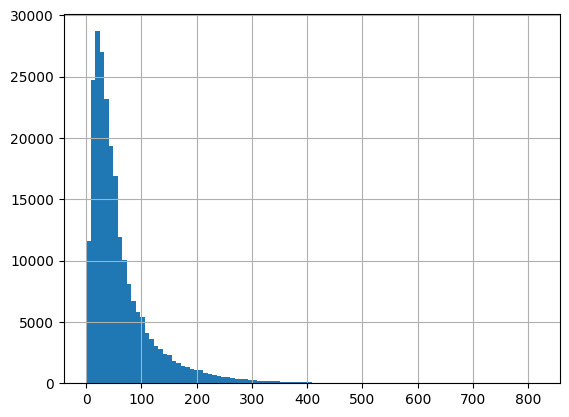

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

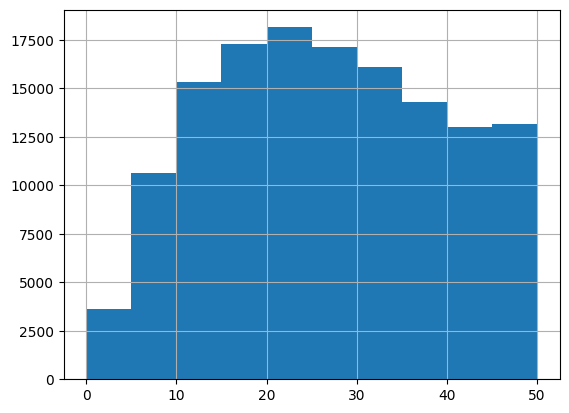

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 46853
Percentage of cells with less than 20 transcripts: 19.93%
-----
Number of cells with less than 15 transcripts: 29552
Percentage of cells with less than 15 transcripts: 12.57%
-----
Number of cells with less than 10 transcripts: 14250
Percentage of cells with less than 10 transcripts: 6.06%
-----
Number total of cells: 235099


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

218117


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


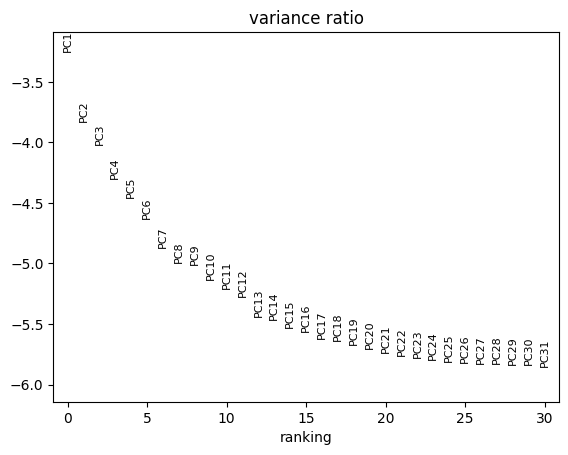

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 218117 × 380
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3565/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


In [49]:
sc.tl.leiden(adata_cells, resolution=0.8, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.8', neighbors_key='pca_n10_pcs16')

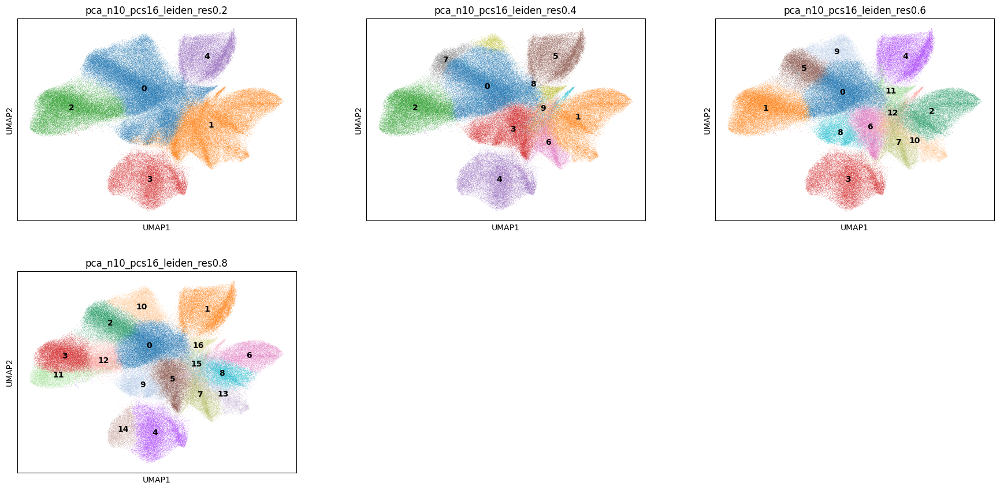

In [50]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.8'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['3', '2', '7', '8', '11', ..., '12', '6', '4', '1', '5']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [51]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.8'].isin(['8']), 'refine_res'] = '13'

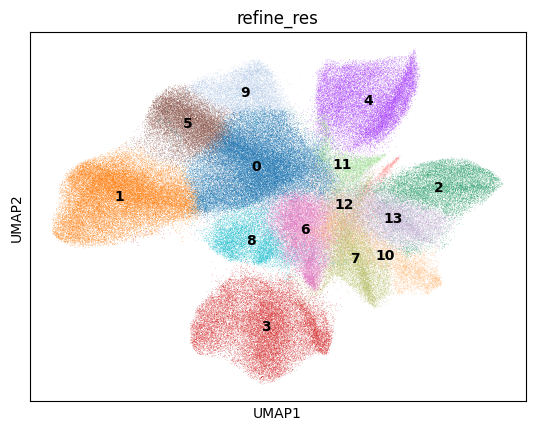

In [52]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [53]:
clustering_label = 'refine_res'

In [54]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

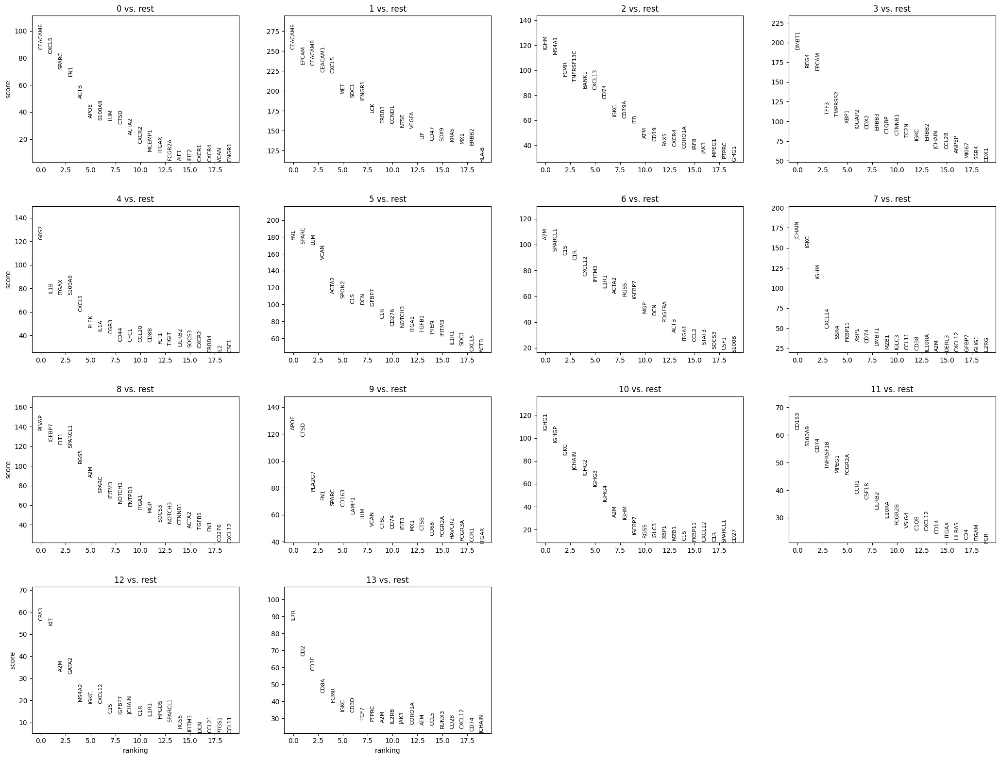

In [55]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [56]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [57]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [58]:
cluster_id = '0'

In [59]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,74.5
1,Macrophage,Macrophage,normal_cell,16.6
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,4.0
3,Fibroblast,CAF,normal_cell,2.1
4,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell,1.1


In [60]:
top_ranked_genes[cluster_id]

0    CEACAM6
1      CXCL5
2      SPARC
3        FN1
4       ACTB
5       APOE
6     S100A9
Name: 0, dtype: object

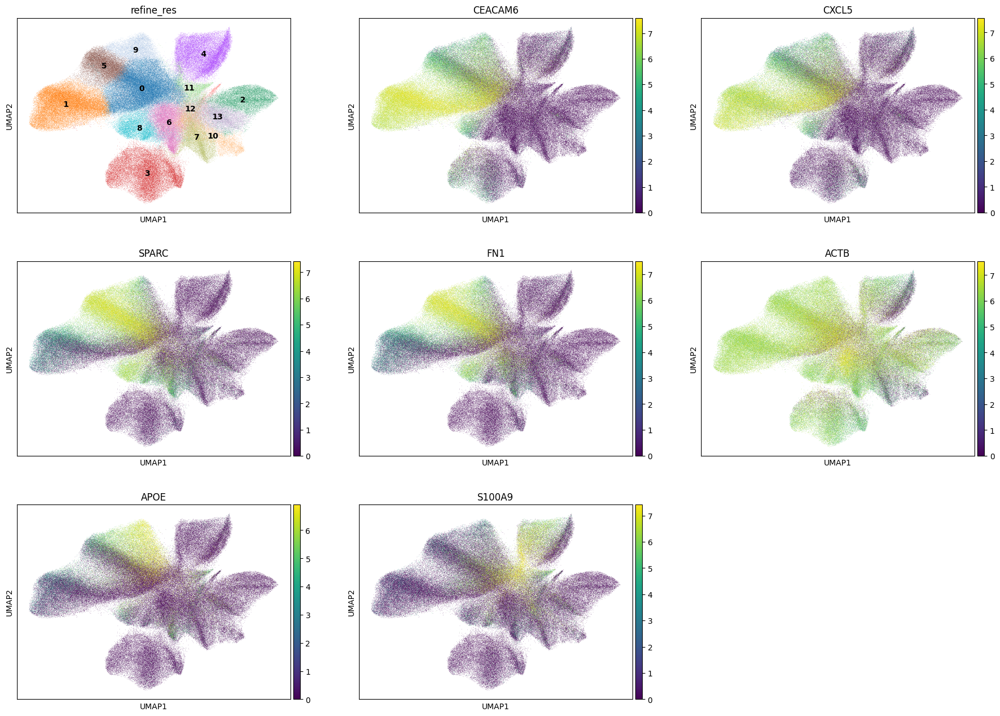

In [61]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [62]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 41644
Percentage of cells in cluster 0: 19.1


In [63]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.2. Cluster 1

In [64]:
cluster_id = '1'

In [65]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell,88.2
1,Macrophage,Macrophage,normal_cell,7.1
2,NA,NA,NA,3.7
3,Fibroblast,CAF,normal_cell,0.5
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.3


In [66]:
top_ranked_genes[cluster_id]

0    CEACAM6
1      EPCAM
2    CEACAM8
3    CEACAM1
4      CXCL5
5        MET
6       SDC1
Name: 1, dtype: object

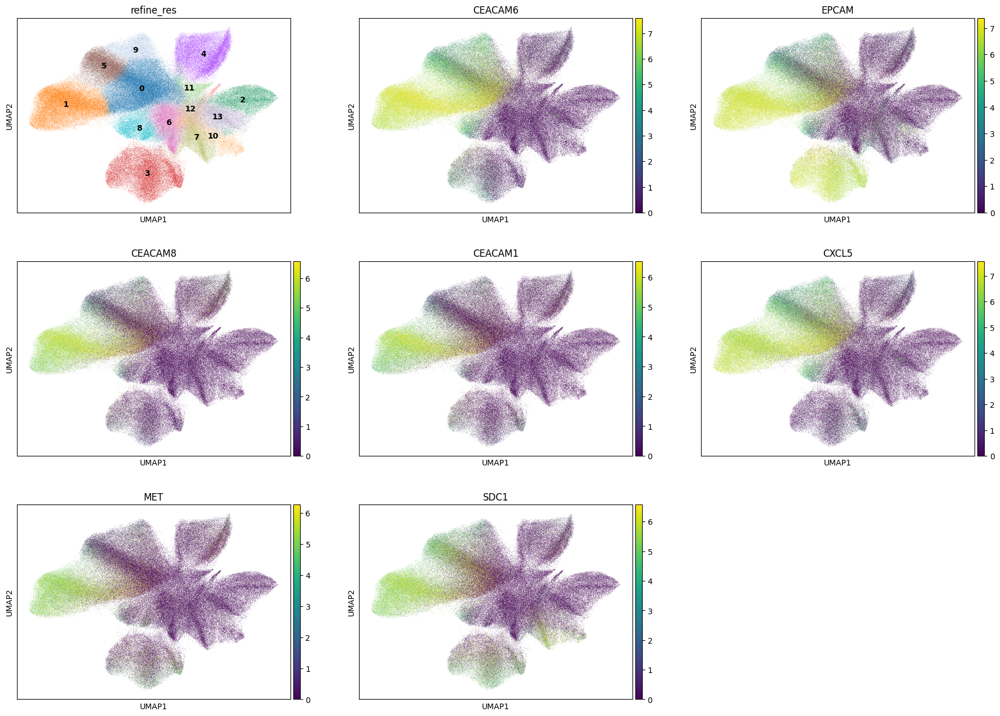

In [67]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [68]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 31898
Percentage of cells in cluster 1: 14.6


In [69]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_epithelial_cell'

### 5.3. Cluster 2

In [70]:
cluster_id = '2'

In [71]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,73.8
1,NA,NA,NA,14.0
2,T,T,normal_cell,6.1
3,Plasma,Plasma,normal_cell,2.2
4,Fibroblast,Fibroblast,normal_cell,1.8


In [72]:
top_ranked_genes[cluster_id]

0         IGHM
1        MS4A1
2         FCMR
3    TNFRSF13C
4        BANK1
5       CXCL13
6         CD74
Name: 2, dtype: object

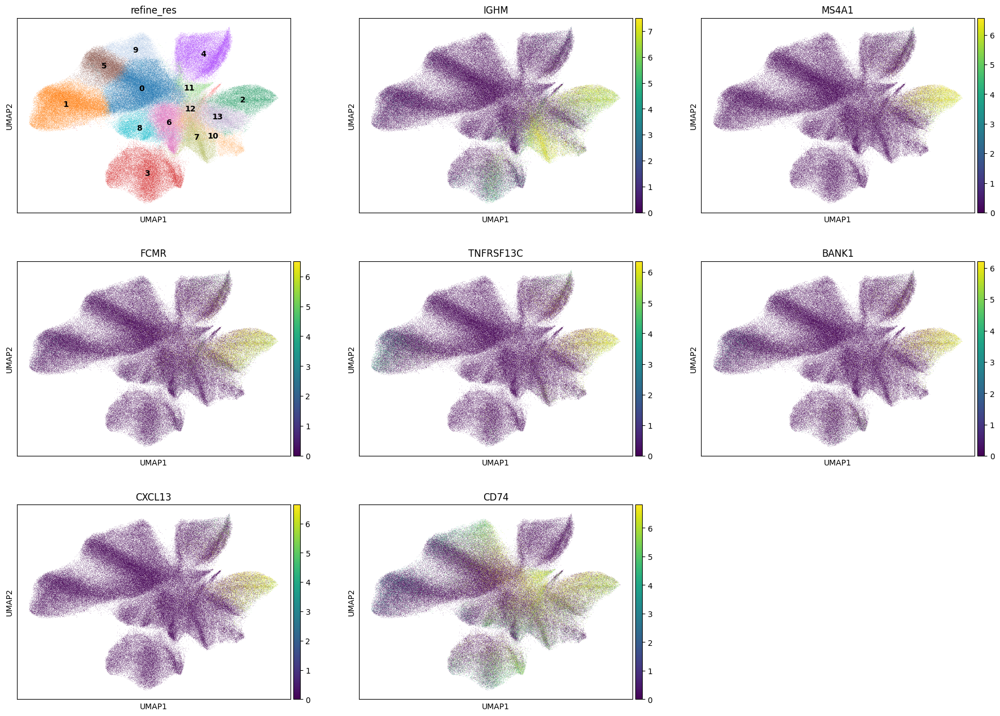

In [73]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [74]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 13225
Percentage of cells in cluster 2: 6.1


In [75]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.4. Cluster 3

In [76]:
cluster_id = '3'

In [77]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell,81.5
1,NA,NA,NA,11.3
2,Mast,Mast,normal_cell,4.1
3,Fibroblast,Fibroblast,normal_cell,0.9
4,Plasma,Plasma,normal_cell,0.8


In [78]:
top_ranked_genes[cluster_id]

0      DMBT1
1       REG4
2      EPCAM
3       TFF3
4    TMPRSS2
5       XBP1
6     IQGAP2
Name: 3, dtype: object

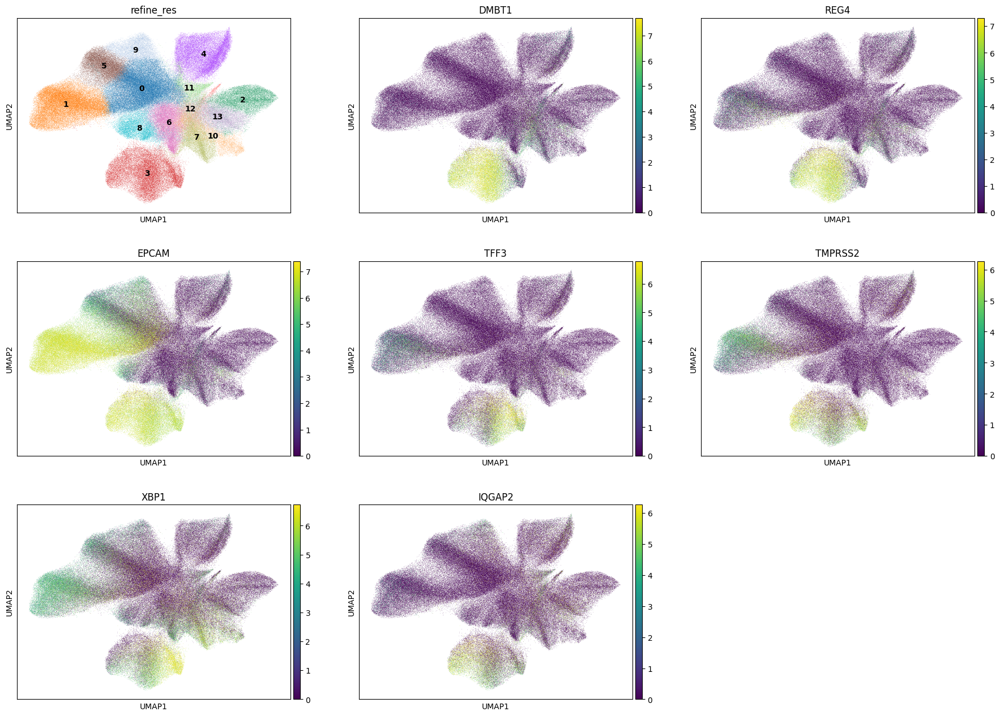

In [79]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [80]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 24225
Percentage of cells in cluster 3: 11.1


In [81]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_epithelial_cell'

### 5.5. Cluster 4

In [82]:
cluster_id = '4'

In [83]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,49.2
1,NA,NA,NA,48.3
2,Macrophage,Macrophage,normal_cell,0.7
3,T,T,normal_cell,0.6
4,Fibroblast,Fibroblast,normal_cell,0.4


In [84]:
top_ranked_genes[cluster_id]

0      G0S2
1      IL1B
2     ITGAX
3    S100A9
4     CXCL1
5      PLEK
6      IL1A
Name: 4, dtype: object

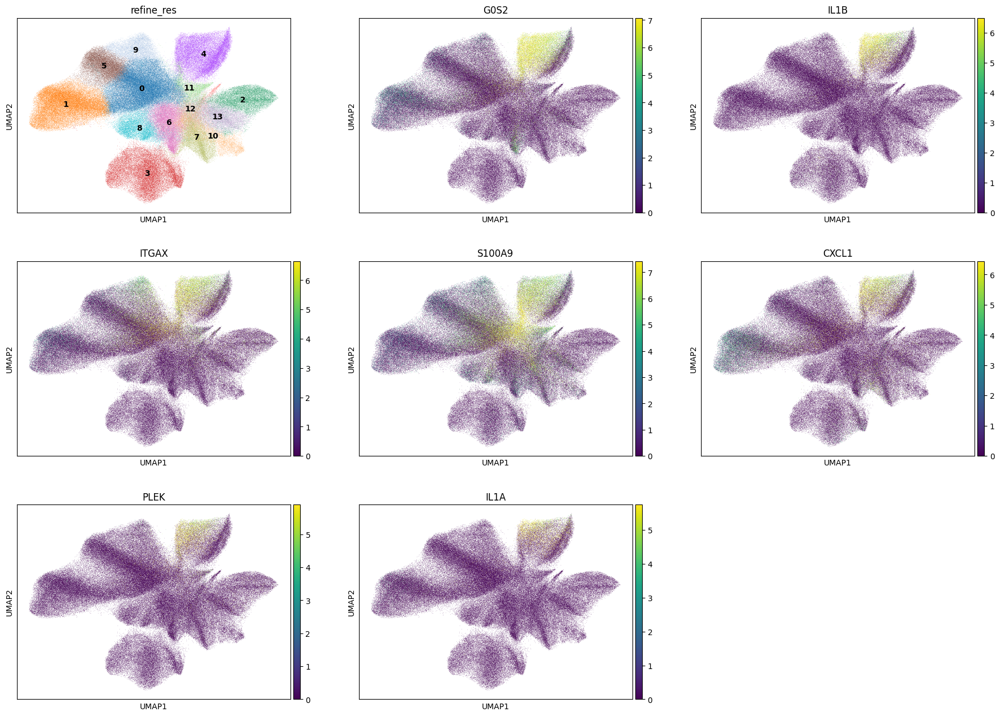

In [85]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [86]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 20503
Percentage of cells in cluster 4: 9.4


In [87]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.6. Cluster 5

In [88]:
cluster_id = '5'

In [89]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,64.4
1,NA,NA,NA,18.2
2,Macrophage,Macrophage,normal_cell,8.7
3,Fibroblast,Fibroblast,normal_cell,3.9
4,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell,2.0


In [90]:
top_ranked_genes[cluster_id]

0      FN1
1    SPARC
2      LUM
3     VCAN
4    ACTA2
5    SPON2
6      C1S
Name: 5, dtype: object

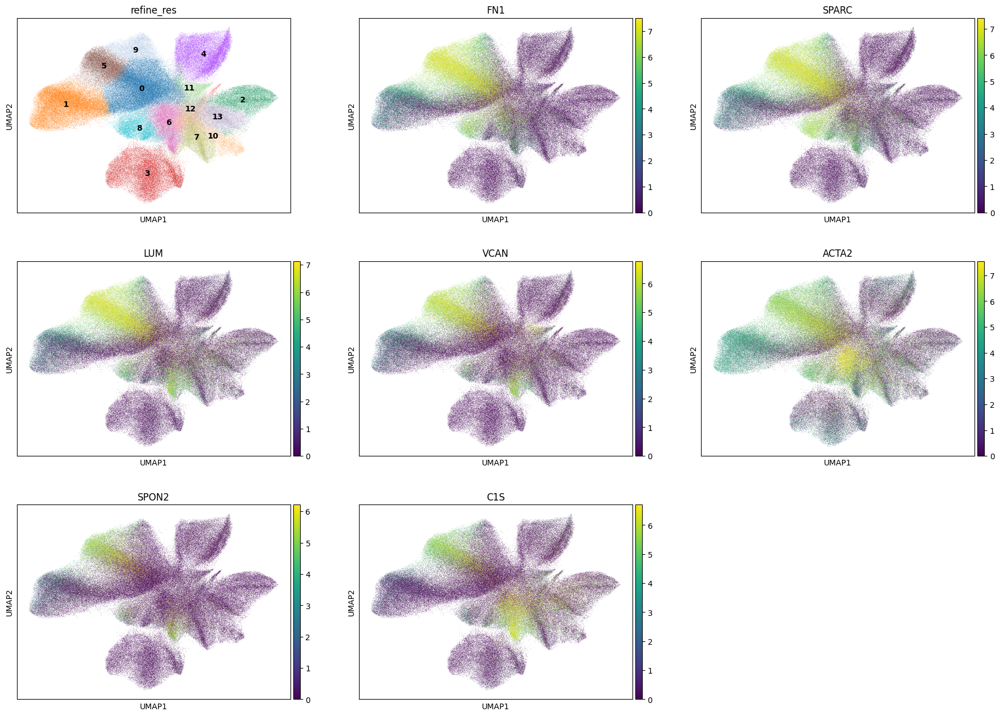

In [91]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 15184
Percentage of cells in cluster 5: 7.0


In [93]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.7. Cluster 6

In [94]:
cluster_id = '6'

In [95]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,48.9
1,NA,NA,NA,44.8
2,Macrophage,Macrophage,normal_cell,1.9
3,Mast,Mast,normal_cell,1.0
4,Fibroblast,CAF,normal_cell,0.9


In [96]:
top_ranked_genes[cluster_id]

0        A2M
1    SPARCL1
2        C1S
3        C1R
4     CXCL12
5     IFITM3
6      IL1R1
Name: 6, dtype: object

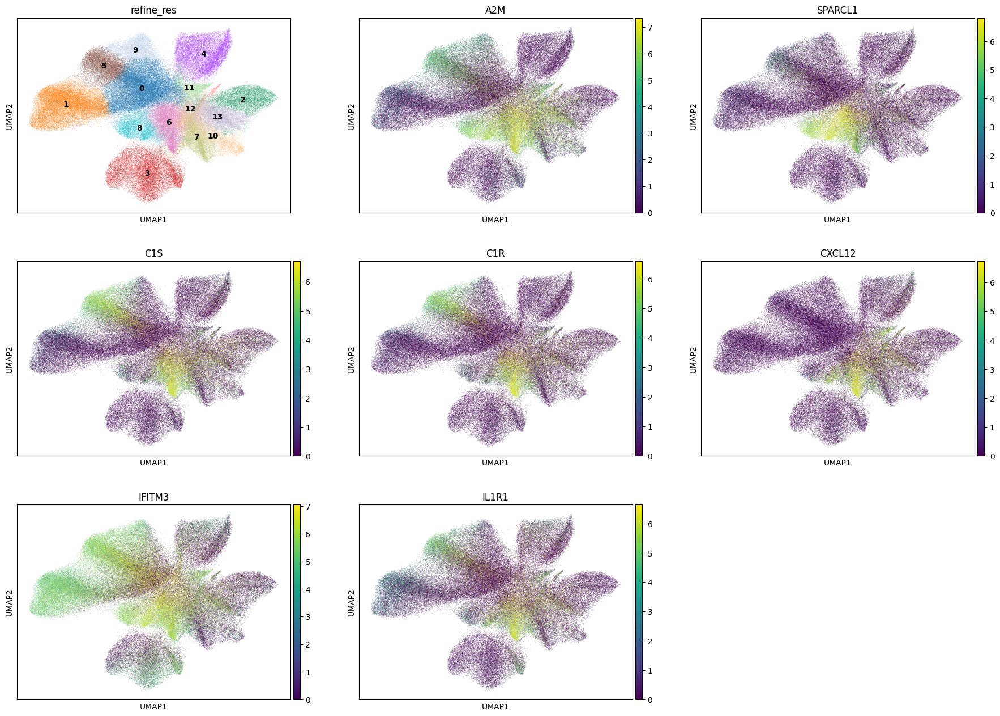

In [97]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 15106
Percentage of cells in cluster 6: 6.9


In [99]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibrablast'

### 5.8. Cluster 7

In [100]:
cluster_id = '7'

In [101]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,44.2
1,NA,NA,NA,23.3
2,Fibroblast,Fibroblast,normal_cell,15.7
3,Macrophage,Macrophage,normal_cell,9.3
4,Mast,Mast,normal_cell,2.5


In [102]:
top_ranked_genes[cluster_id]

0    JCHAIN
1      IGKC
2      IGHM
3    CXCL14
4      SSR4
5    FKBP11
6      XBP1
Name: 7, dtype: object

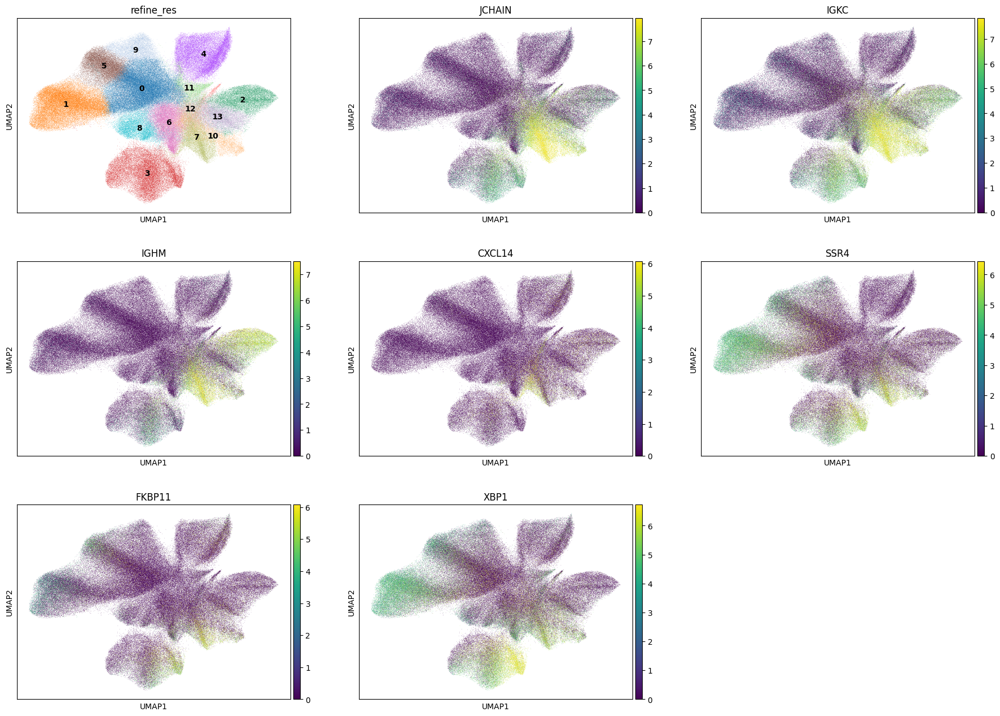

In [103]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [104]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 11492
Percentage of cells in cluster 7: 5.3


In [105]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.9. Cluster 8

In [106]:
cluster_id = '8'

In [107]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Angiogenesis_endothelial_cell,normal_cell,47.3
1,NA,NA,NA,17.7
2,Fibroblast,Fibroblast,normal_cell,15.3
3,Mast,Mast,normal_cell,7.5
4,Macrophage,Macrophage,normal_cell,4.5


In [108]:
top_ranked_genes[cluster_id]

0      PLVAP
1     IGFBP7
2       FLT1
3    SPARCL1
4       RGS5
5        A2M
6      SPARC
Name: 8, dtype: object

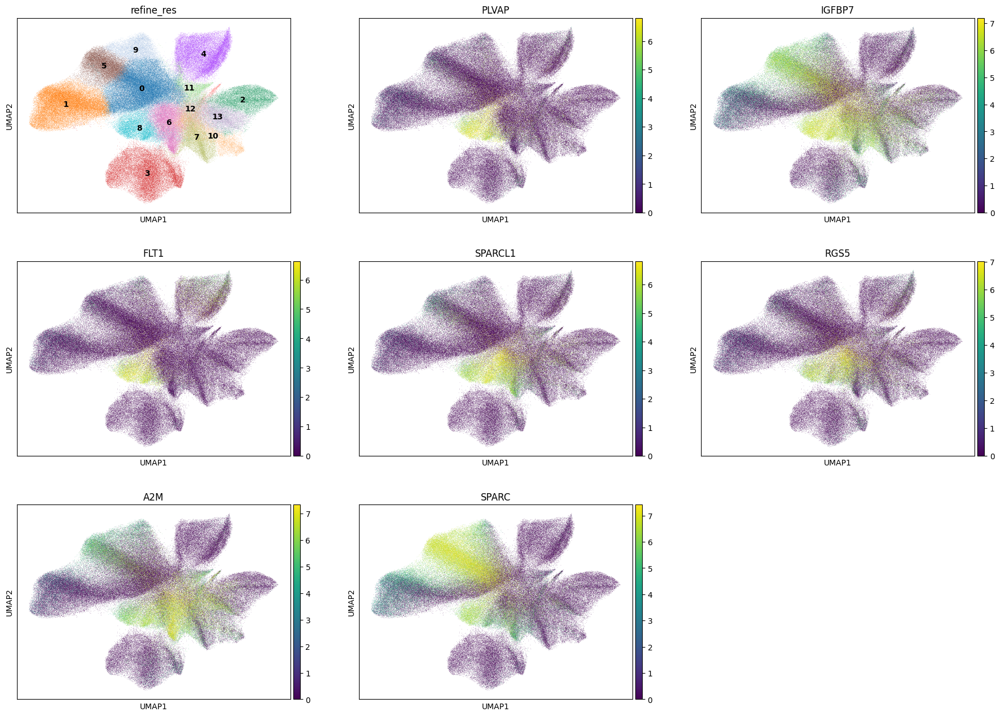

In [109]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [110]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 9810
Percentage of cells in cluster 8: 4.5


In [111]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.10. Cluster 9

In [112]:
cluster_id = '9'

In [113]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,63.3
1,Fibroblast,CAF,normal_cell,18.6
2,NA,NA,NA,13.1
3,Epithelial,Pancreatic_ductal_epithelial_cell,cancer_cell,1.9
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.2


In [114]:
top_ranked_genes[cluster_id]

0      APOE
1      CTSD
2    PLA2G7
3       FN1
4     SPARC
5     CD163
6     LAMP1
Name: 9, dtype: object

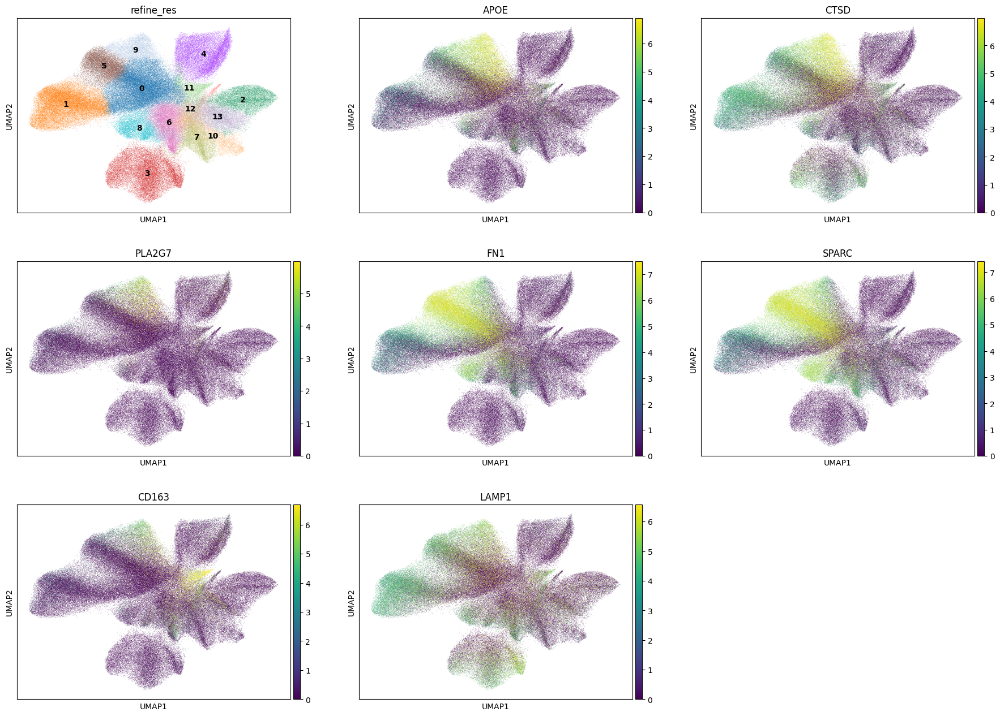

In [115]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [116]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 7754
Percentage of cells in cluster 9: 3.6


In [117]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.11. Cluster 10

In [118]:
cluster_id = '10'

In [119]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,40.0
1,NA,NA,NA,33.9
2,Fibroblast,Fibroblast,normal_cell,14.6
3,Macrophage,Macrophage,normal_cell,2.7
4,T,T,normal_cell,2.6


In [120]:
top_ranked_genes[cluster_id]

0     IGHG1
1     IGHGP
2      IGKC
3    JCHAIN
4     IGHG2
5     IGHG3
6     IGHG4
Name: 10, dtype: object

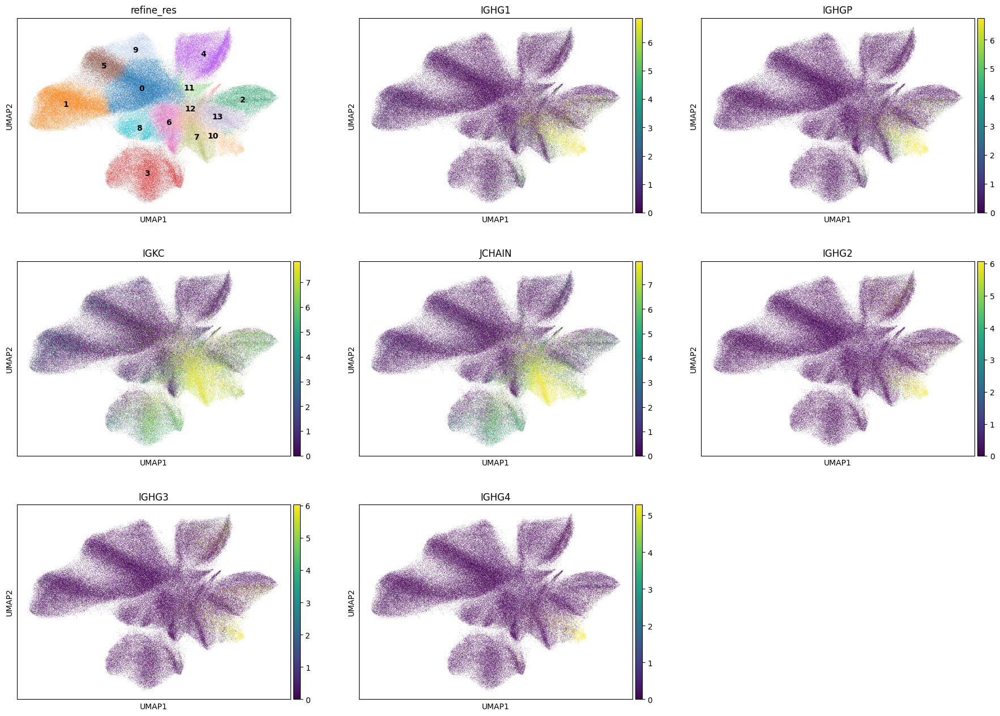

In [122]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [123]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 6661
Percentage of cells in cluster 10: 3.1


In [124]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.12. Cluster 11

In [125]:
cluster_id = '11'

In [126]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,52.5
1,NA,NA,NA,24.5
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,18.2
3,Fibroblast,Fibroblast,normal_cell,2.4
4,Plasma,Plasma,normal_cell,1.1


In [127]:
top_ranked_genes[cluster_id]

0       CD163
1      S100A9
2        CD74
3    TNFRSF1B
4       MPEG1
5      FCGR2A
6        CCR1
Name: 11, dtype: object

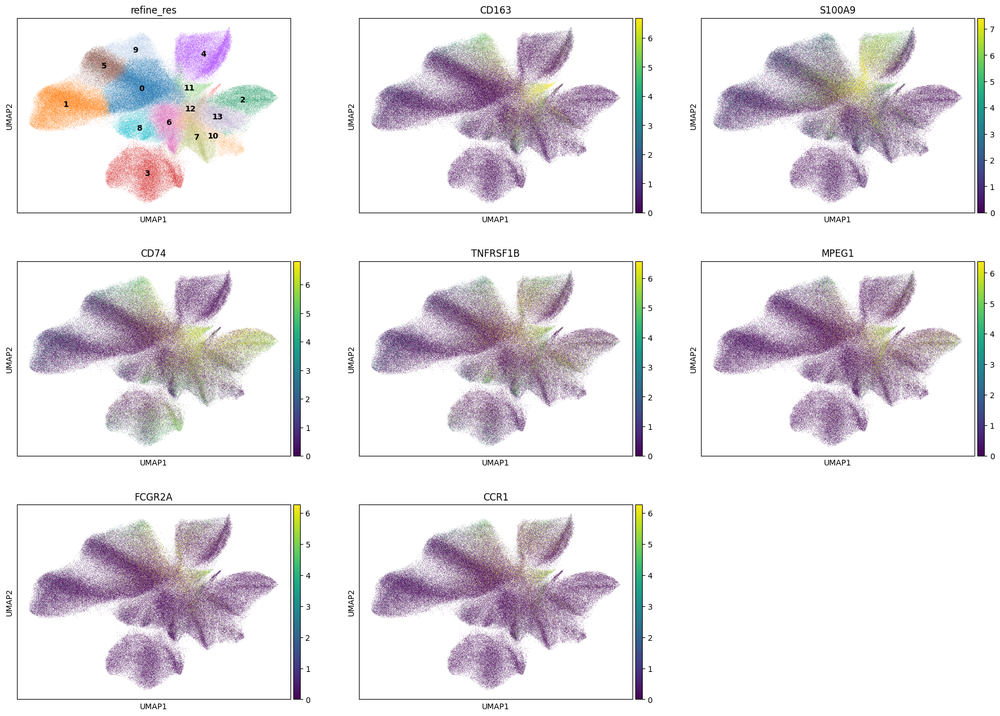

In [129]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [130]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 4783
Percentage of cells in cluster 11: 2.2


In [131]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.13. Cluster 12

In [132]:
cluster_id = '12'

In [133]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,45.3
1,Mast,Mast,normal_cell,33.7
2,Fibroblast,Fibroblast,normal_cell,10.6
3,Macrophage,Macrophage,normal_cell,3.2
4,T,T,normal_cell,2.4


In [134]:
top_ranked_genes[cluster_id]

0      CPA3
1       KIT
2       A2M
3     GATA2
4     MS4A2
5      IGKC
6    CXCL12
Name: 12, dtype: object

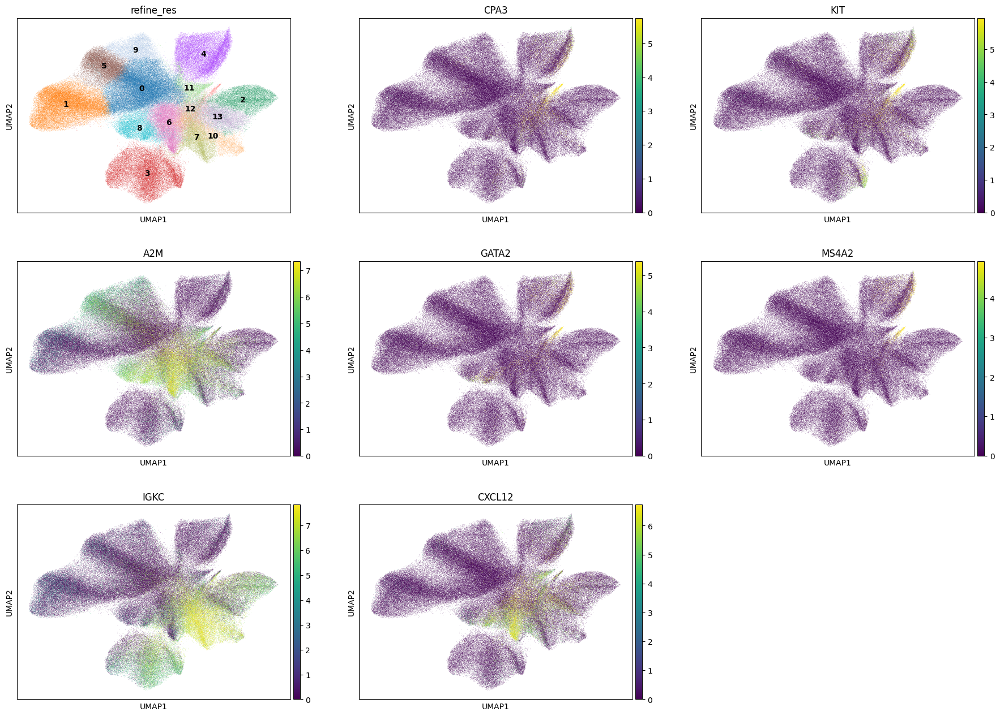

In [136]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [137]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 4279
Percentage of cells in cluster 12: 2.0


In [138]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.14. Cluster 13

In [139]:
cluster_id = '13'

In [140]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,59.9
1,NA,NA,NA,25.1
2,Fibroblast,Fibroblast,normal_cell,4.1
3,B,B,normal_cell,3.9
4,Macrophage,Macrophage,normal_cell,2.2


In [141]:
top_ranked_genes[cluster_id]

0    IL7R
1     CD2
2    CD3E
3    CD8A
4    FCMR
5    IGKC
6    CD3D
Name: 13, dtype: object

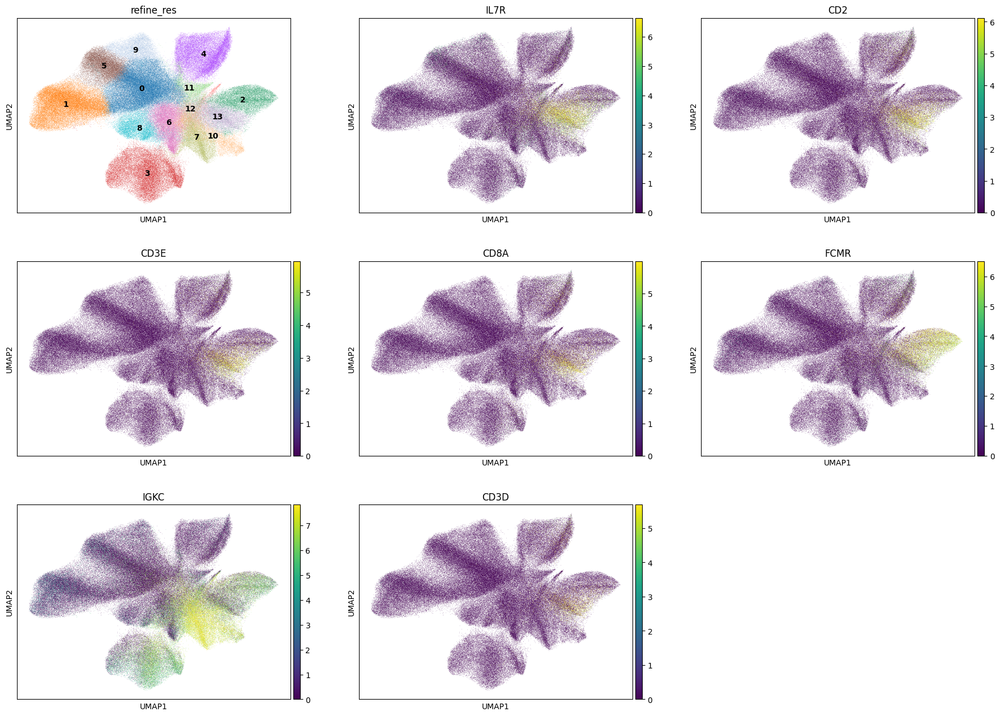

In [143]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [144]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 11553
Percentage of cells in cluster 13: 5.3


In [145]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

## 6. Cancer cells

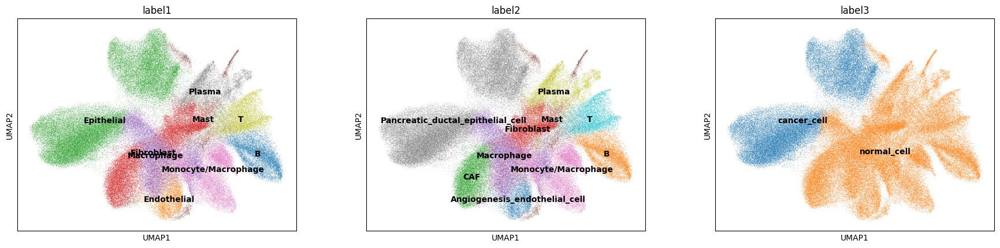

In [148]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

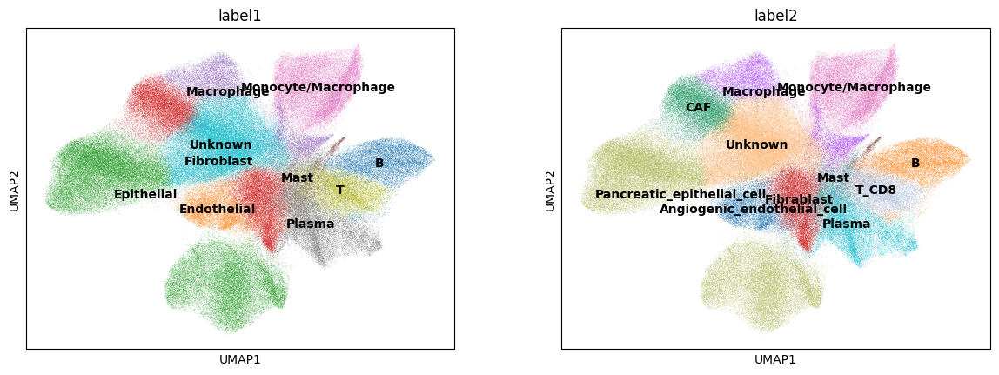

In [149]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [150]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

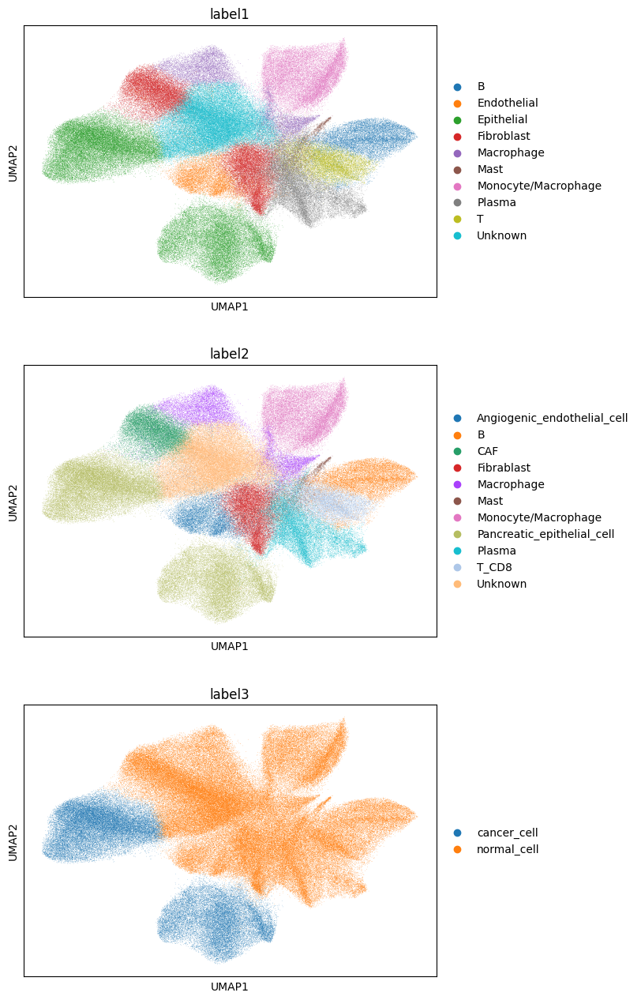

In [151]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [152]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,pca_n10_pcs16_leiden_res0.8,label3
0,aaaaaaaa-1,181,0,0,0,0,181,116.503129,27.274376,cell_labels,5.0,1.0,3,4,3,3,Epithelial,Pancreatic_epithelial_cell,14,cancer_cell
1,aaaaaaab-1,72,0,0,0,0,72,35.899220,6.050938,cell_labels,5.0,1.0,3,1,2,2,B,B,14,normal_cell
2,aaaaaaac-1,77,0,0,0,0,77,58.567658,32.060939,cell_labels,5.0,1.0,3,4,3,3,Epithelial,Pancreatic_epithelial_cell,14,cancer_cell
3,aaaaaaad-1,77,0,0,0,0,77,57.483908,27.319532,cell_labels,5.0,1.0,3,4,3,3,Epithelial,Pancreatic_epithelial_cell,14,cancer_cell
4,aaaaaaae-1,198,0,0,0,0,198,187.398444,30.525626,cell_labels,5.0,1.0,1,6,7,7,Plasma,Plasma,7,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235094,aaadjgfg-1,71,0,0,0,0,71,100.698441,15.488594,cell_labels,6.0,1.0,4,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,1,normal_cell
235095,aaadjgfh-1,159,1,0,0,0,160,151.589537,47.368908,cell_labels,5.0,1.0,4,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,1,normal_cell
235096,aaadjgfi-1,56,0,0,0,0,56,44.885314,6.908907,cell_labels,6.0,1.0,4,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,1,normal_cell
235097,aaadjgfj-1,32,0,0,0,0,32,38.247345,6.818594,cell_labels,6.0,1.0,4,5,4,4,Monocyte/Macrophage,Monocyte/Macrophage,1,normal_cell


In [153]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")